<a href="https://colab.research.google.com/github/T-Yamaguch/GAN/blob/master/GAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
import tensorflow as tf
from tensorflow.keras import Model
from tensorflow.keras.layers import Input, Concatenate, Conv2D, \
MaxPooling2D, Activation, ReLU, LeakyReLU, UpSampling2D, BatchNormalization, \
Dropout, Dense, Flatten, Add, LayerNormalization, GaussianNoise, Reshape
from keras.regularizers import l2

class conv_block(Model):
  def __init__(self, filter_num, kernel_size, kernel_regularizer= l2(0.001)):
    super(conv_block, self).__init__()
    self.conv = Conv2D(filter_num, kernel_size, padding = 'same', kernel_regularizer= kernel_regularizer)
    self.norm = BatchNormalization(trainable=True)
    self.act = ReLU()
    self.up = UpSampling2D((2,2))
    self.noise = GaussianNoise(0.2)

  def call(self, x):
    x = self.conv(x)
    x = self.norm(x)
    x = self.act(x)
    x = self.up(x)
    x = self.noise(x)
    return x

class res_block(Model):
  def __init__(self, filter_num, kernel_size, kernel_regularizer= l2(0.001)):
    super(res_block, self).__init__()
    self.conv1 = Conv2D(filter_num, kernel_size, padding = 'same', kernel_regularizer= kernel_regularizer)
    self.conv2 = Conv2D(filter_num, kernel_size, padding = 'same', kernel_regularizer= kernel_regularizer)
    self.norm1 = BatchNormalization(trainable=True)
    self.norm2 = BatchNormalization(trainable=True)
    self.act1 = ReLU()
    self.act2 = ReLU()
    self.add = Add()

  def call(self, x):
    y = self.conv1(x)
    y = self.norm1(y)
    y = self.act1(y)
    y = self.conv2(y)
    y = self.norm2(y)
    y = self.act2(y)
    x = self.add([x, y])
    return x

class disc_block(Model):
  def __init__(self, filter_num, kernel_size, kernel_regularizer= l2(0.001)):
    super(disc_block, self).__init__()
    self.conv = Conv2D(filter_num, kernel_size, padding = 'same', kernel_regularizer= kernel_regularizer)
    self.norm = BatchNormalization(trainable=True)
    self.act = ReLU()
    self.pooling = MaxPooling2D((2,2), strides=(2,2))
    self.drop = Dropout(0.3)

  def call(self, x):
    x = self.conv(x)
    x = self.norm(x)
    x = self.act(x)
    x = self.pooling(x)
    x = self.drop(x)
    return x

class dense_block(Model):
  def __init__(self, filter_num, kernel_regularizer= l2(0.001)):
    super(dense_block, self).__init__()
    self.dense = Dense(filter_num, kernel_regularizer= kernel_regularizer)
    self.norm = BatchNormalization(trainable=True)
    self.act = ReLU()

  def call(self, x):
    x = self.dense(x)
    x = self.norm(x)
    x = self.act(x)
    return x




In [3]:
class Generator():
  def __init__(self):
    self.channel_num = 256
    self.layer_num = 5
    self.res_num = 0
    self.latent_num = 8
    self.inputs = Input(shape=(self.latent_num)) 
    self.kernel_size = (5, 5)
    self.name = 'generator'
    self.kernel_regularizer= l2(1E-8)
      
  def model(self):
    x = self.inputs

    final_size = 4*4*self.channel_num
    data_size = self.latent_num

    while data_size*4 < final_size:
      data_size *= 4
      x = dense_block(data_size, kernel_regularizer= self.kernel_regularizer)(x)

    x = dense_block(final_size, kernel_regularizer= self.kernel_regularizer)(x)
    x = Reshape((4, 4, self.channel_num))(x)

    filter_num = self.channel_num
    
    for n in range(self.layer_num):
      for m in range(self.res_num):
        x = res_block(filter_num, self.kernel_size, kernel_regularizer= self.kernel_regularizer)(x)
      x = conv_block(filter_num, self.kernel_size, kernel_regularizer= self.kernel_regularizer)(x)

    for m in range(self.res_num):
      x = res_block(filter_num, self.kernel_size, kernel_regularizer= self.kernel_regularizer)(x)

    x = Conv2D(filter_num, self.kernel_size, padding = 'same', kernel_regularizer= self.kernel_regularizer)(x)
    x = BatchNormalization(trainable=True)(x)
    x = ReLU()(x)

    x = Conv2D(3, (1,1), padding='same')(x)
    x = Activation('sigmoid')(x)
    outputs = x
    return Model(inputs = self.inputs, outputs = outputs, name = self.name)

g = Generator()
g.model().summary()

Model: "generator"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 8)]               0         
_________________________________________________________________
dense_block (dense_block)    (None, 32)                416       
_________________________________________________________________
dense_block_1 (dense_block)  (None, 128)               4736      
_________________________________________________________________
dense_block_2 (dense_block)  (None, 512)               68096     
_________________________________________________________________
dense_block_3 (dense_block)  (None, 2048)              1058816   
_________________________________________________________________
dense_block_4 (dense_block)  (None, 4096)              8409088   
_________________________________________________________________
reshape (Reshape)            (None, 4, 4, 256)         0 

In [4]:
class Discriminator():
  def __init__(self):
    self.channel_num = 8
    self.layer_num = 5
    self.latent_num = 8
    self.inputs = Input(shape=(128, 128, 3))
    self.kernel_size = (3, 3)
    self.name = 'discriminator'
    self.kernel_regularizer= l2(1E-8)
      
  def model(self):
    x = self.inputs
    filter_num = self.channel_num
    for n in range(self.layer_num):
      x = disc_block(filter_num, self.kernel_size, kernel_regularizer= self.kernel_regularizer)(x)
      filter_num *= 2

    x = Flatten()(x)
    x = dense_block(512, kernel_regularizer= self.kernel_regularizer)(x)

    x1 = Dense(1)(x)
    x1 = Activation('sigmoid')(x1)

    x2 = Dense(self.latent_num)(x)
    x2 = Activation('sigmoid')(x2)

    outputs = [x1, x2]

    return Model(inputs = self.inputs, outputs = outputs, name = self.name)

d = Discriminator()
d.model().summary()

Model: "discriminator"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 128, 128, 3) 0                                            
__________________________________________________________________________________________________
disc_block (disc_block)         (None, 64, 64, 8)    256         input_2[0][0]                    
__________________________________________________________________________________________________
disc_block_1 (disc_block)       (None, 32, 32, 16)   1232        disc_block[0][0]                 
__________________________________________________________________________________________________
disc_block_2 (disc_block)       (None, 16, 16, 32)   4768        disc_block_1[0][0]               
______________________________________________________________________________________


epochs 1
steps128

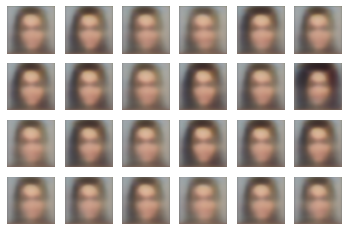


epochs 2
steps128

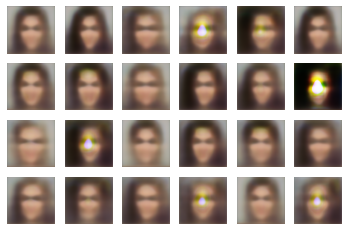


epochs 3
steps128

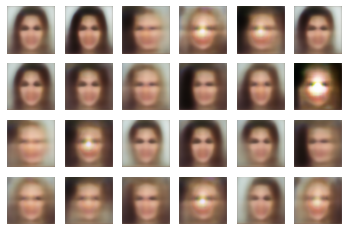


epochs 4
steps128

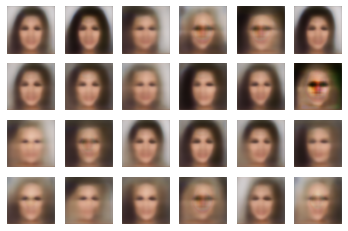


epochs 5
steps128

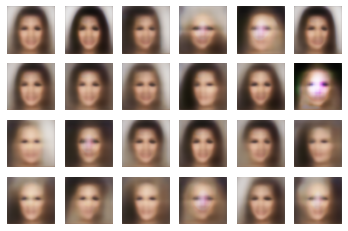


epochs 6
steps128

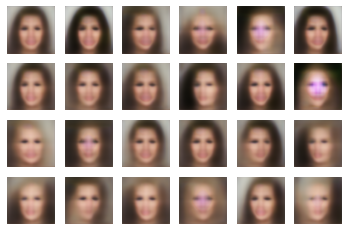


epochs 7
steps128

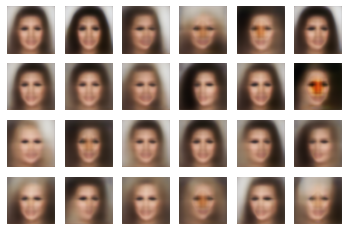


epochs 8
steps128

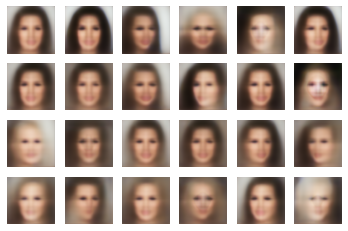


epochs 9
steps128

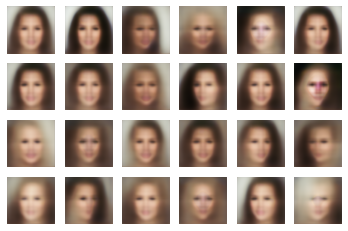


epochs 10
steps128

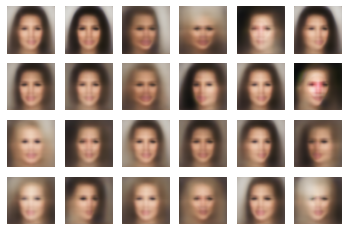


Saving checkpoint at epoch10



epochs 11
steps128

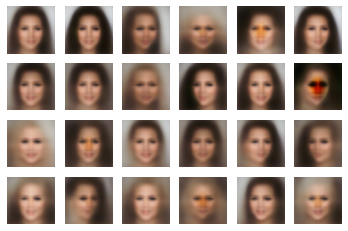


epochs 12
steps128

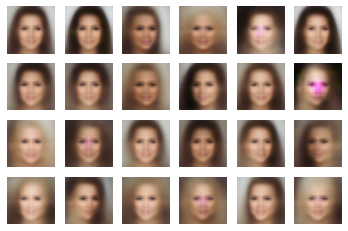


epochs 13
steps128

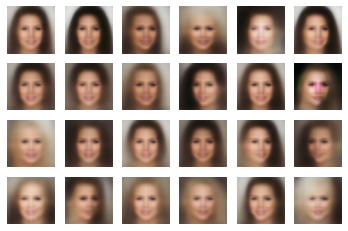


epochs 14
steps128

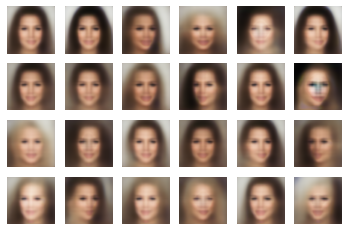


epochs 15
steps128

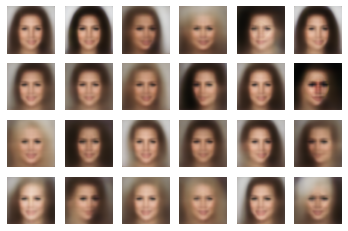


epochs 16
steps128

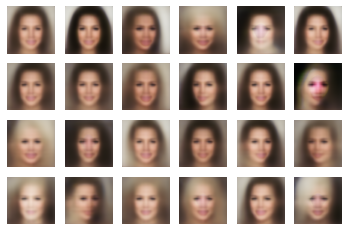


epochs 17
steps128

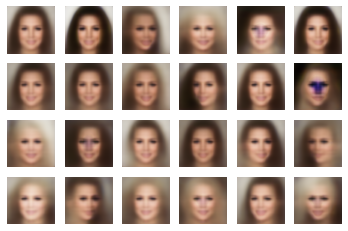


epochs 18
steps128

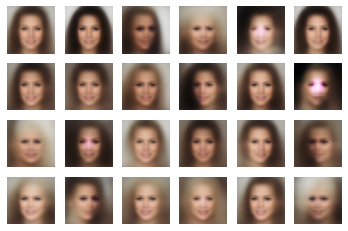


epochs 19
steps128

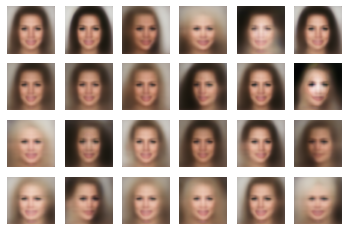


epochs 20
steps128

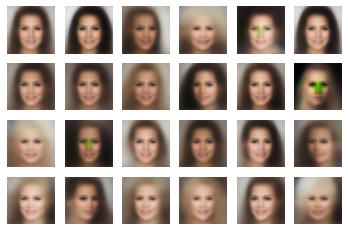


Saving checkpoint at epoch20



epochs 21
steps128

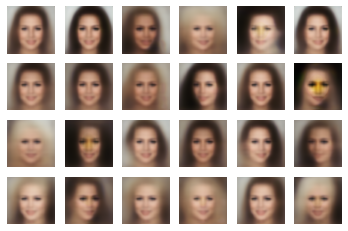


epochs 22
steps128

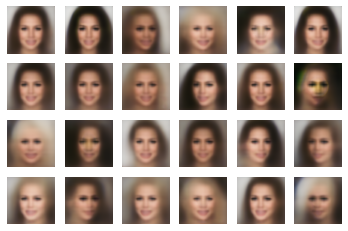


epochs 23
steps128

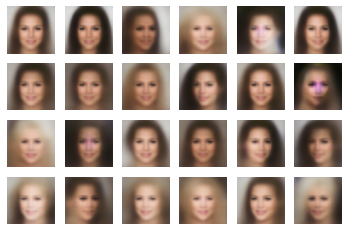


epochs 24
steps128

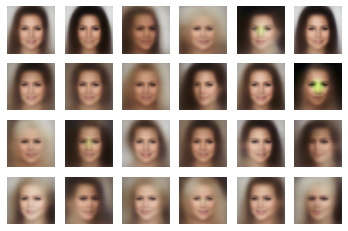


epochs 25
steps128

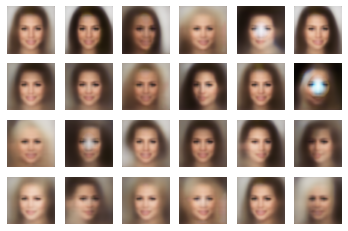


epochs 26
steps128

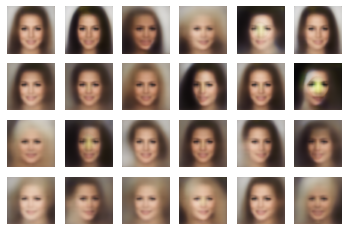


epochs 27
steps128

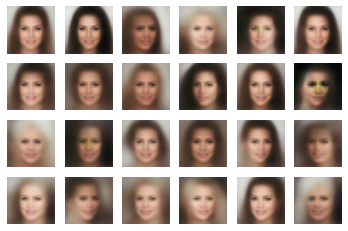


epochs 28
steps128

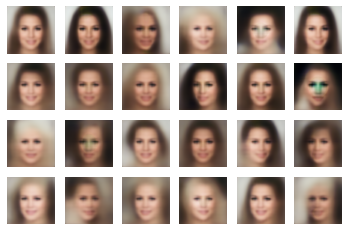


epochs 29
steps128

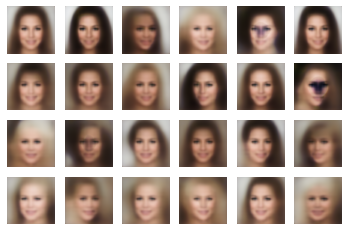


epochs 30
steps128

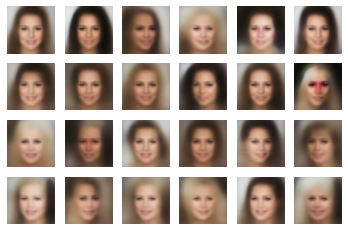


Saving checkpoint at epoch30



epochs 31
steps128

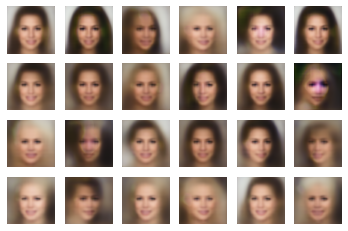


epochs 32
steps128

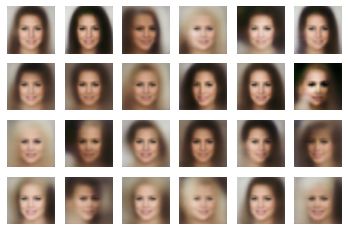


epochs 33
steps128

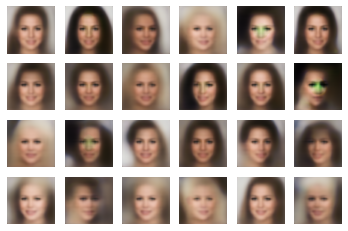


epochs 34
steps128

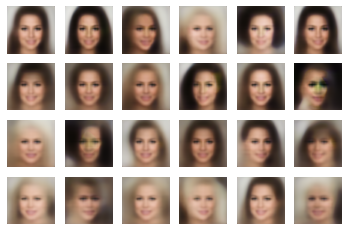


epochs 35
steps128

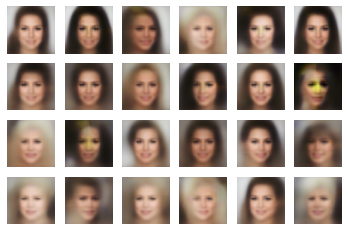


epochs 36
steps128

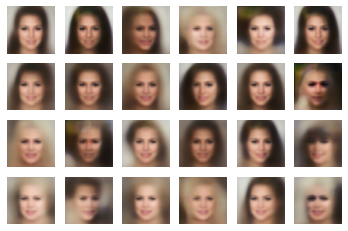


epochs 37
steps128

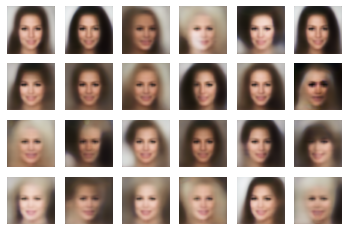


epochs 38
steps128

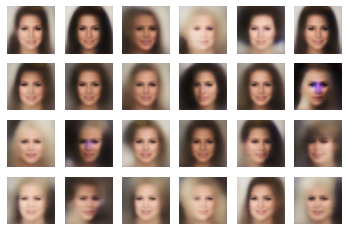


epochs 39
steps128

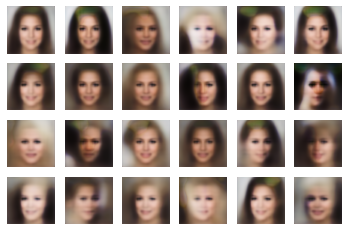


epochs 40
steps128

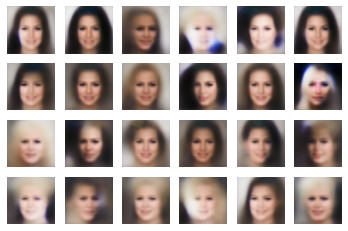


Saving checkpoint at epoch40



epochs 41
steps128

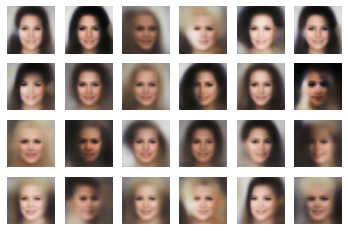


epochs 42
steps128

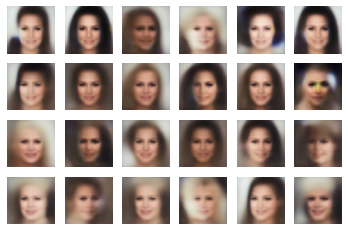


epochs 43
steps128

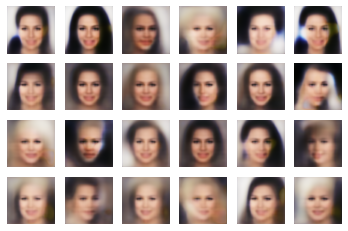


epochs 44
steps128

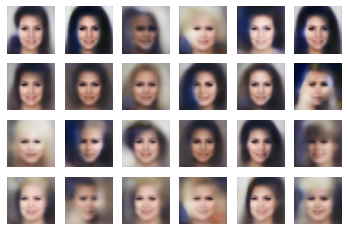


epochs 45
steps128

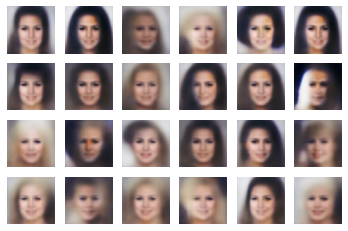


epochs 46
steps128

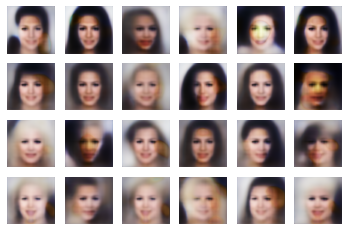


epochs 47
steps128

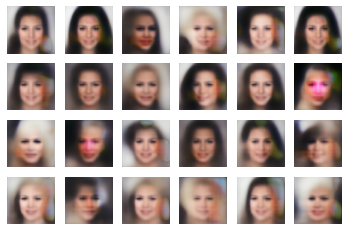


epochs 48
steps128

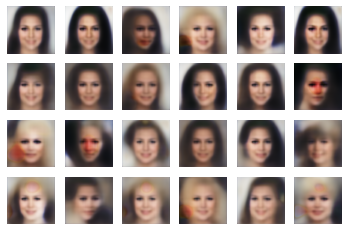


epochs 49
steps128

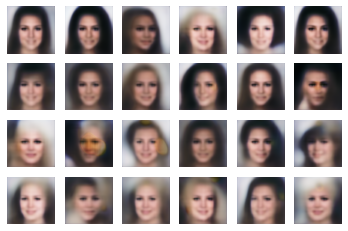


epochs 50
steps128

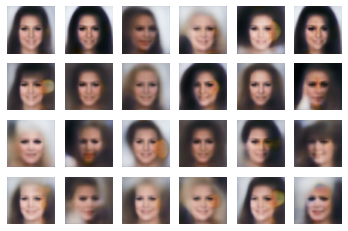


Saving checkpoint at epoch50



epochs 51
steps128

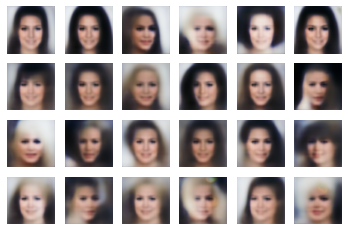


epochs 52
steps128

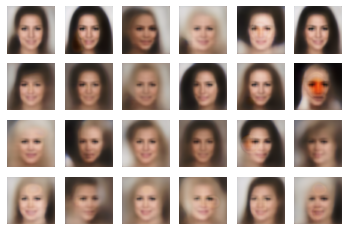


epochs 53
steps128

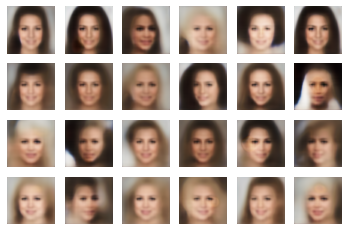


epochs 54
steps128

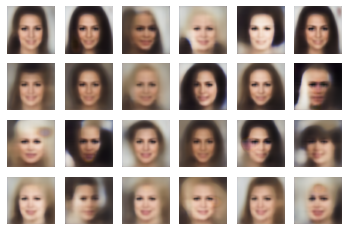


epochs 55
steps128

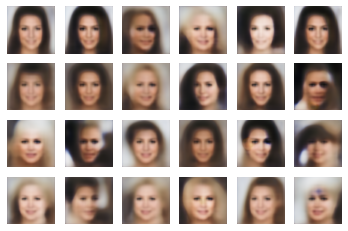


epochs 56
steps128

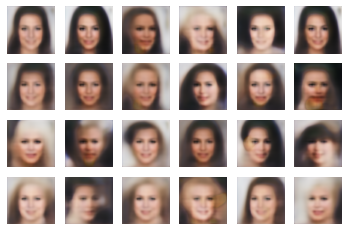


epochs 57
steps128

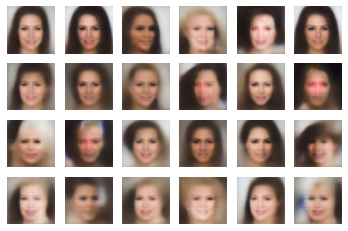


epochs 58
steps128

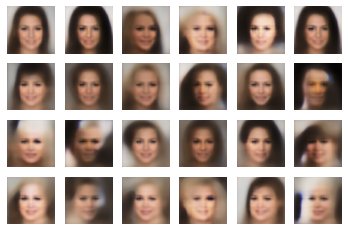


epochs 59
steps128

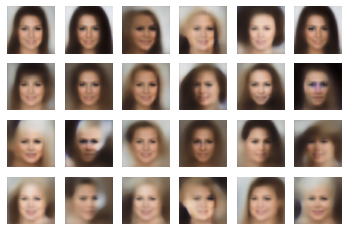


epochs 60
steps128

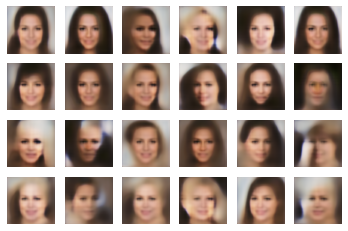


Saving checkpoint at epoch60



epochs 61
steps128

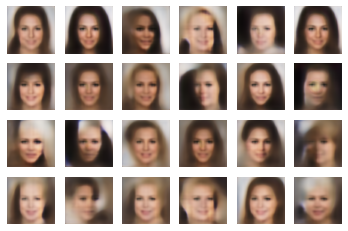


epochs 62
steps128

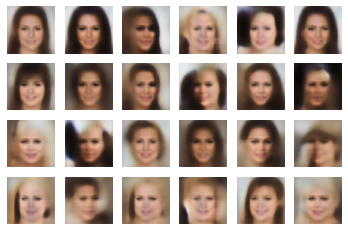


epochs 63
steps128

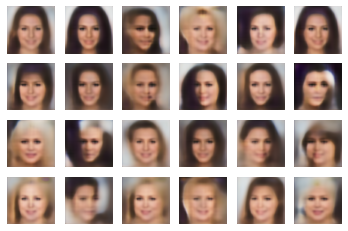


epochs 64
steps128

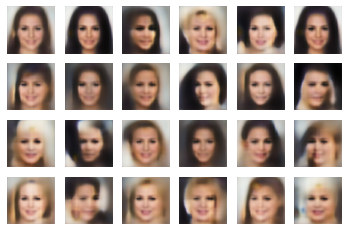


epochs 65
steps128

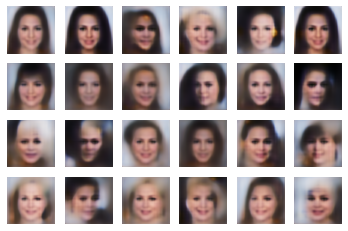


epochs 66
steps128

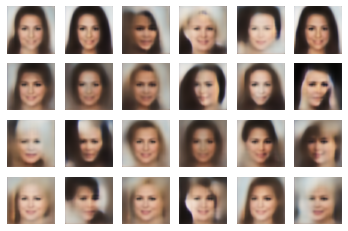


epochs 67
steps128

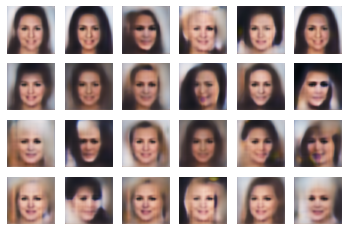


epochs 68
steps128

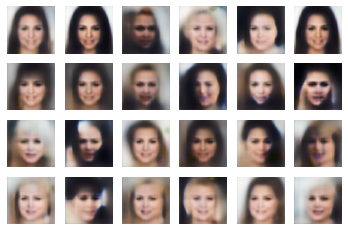


epochs 69
steps128

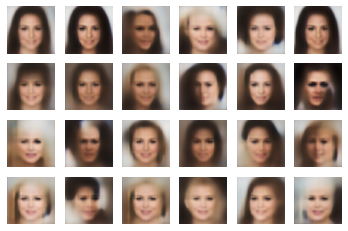


epochs 70
steps128

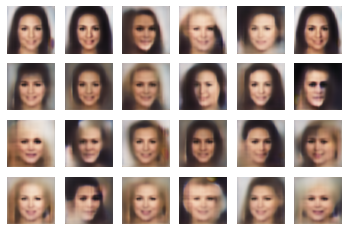


Saving checkpoint at epoch70



epochs 71
steps128

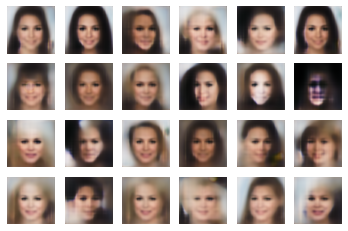


epochs 72
steps128

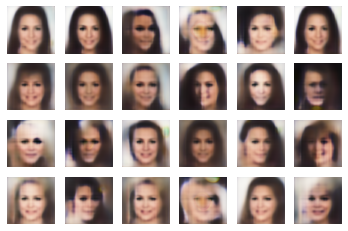


epochs 73
steps128

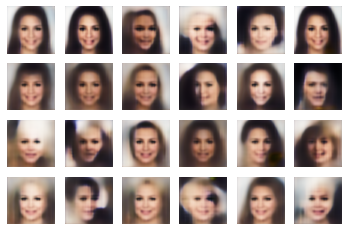


epochs 74
steps128

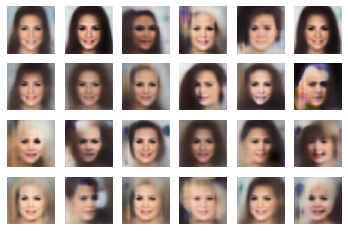


epochs 75
steps128

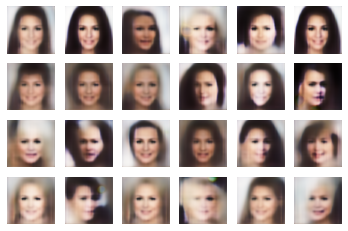


epochs 76
steps128

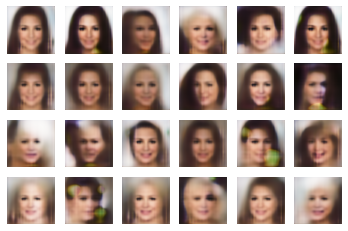


epochs 77
steps128

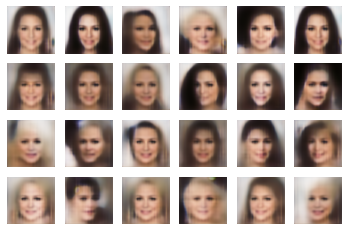


epochs 78
steps128

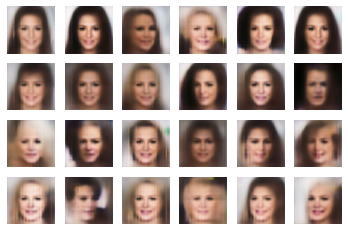


epochs 79
steps128

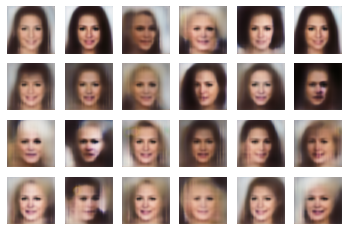


epochs 80
steps128

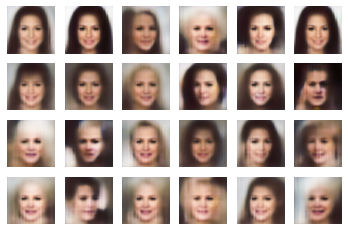


Saving checkpoint at epoch80



epochs 81
steps128

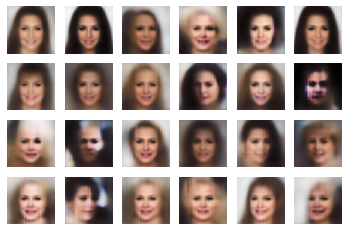


epochs 82
steps128

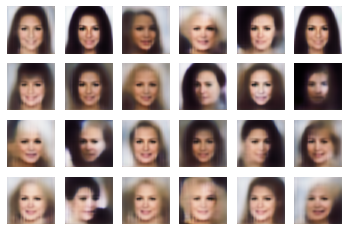


epochs 83
steps128

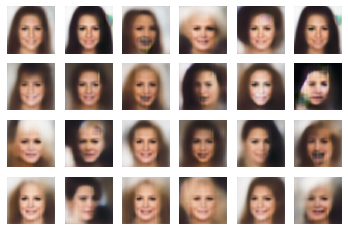


epochs 84
steps128

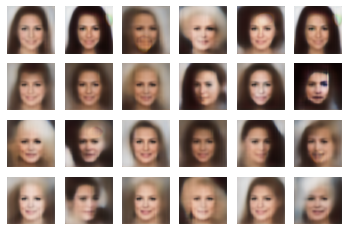


epochs 85
steps128

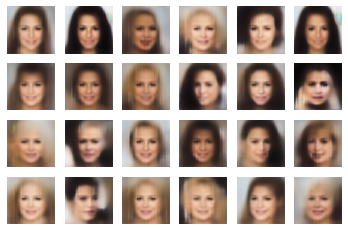


epochs 86
steps128

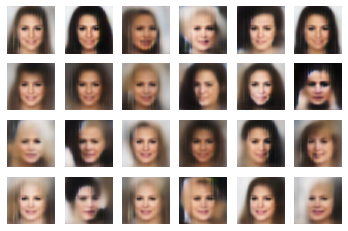


epochs 87
steps128

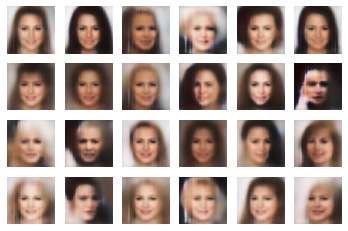


epochs 88
steps128

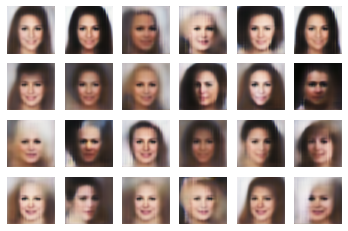


epochs 89
steps128

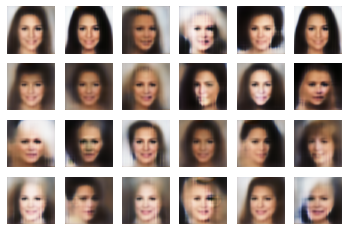


epochs 90
steps128

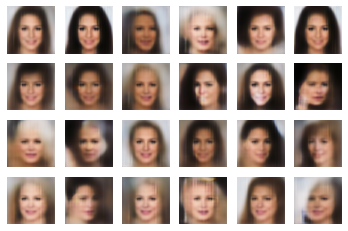


Saving checkpoint at epoch90



epochs 91
steps128

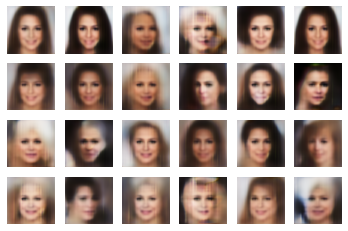


epochs 92
steps128

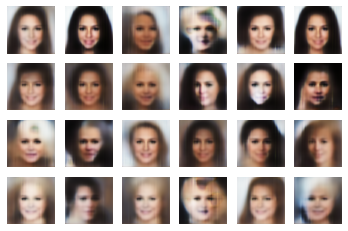


epochs 93
steps128

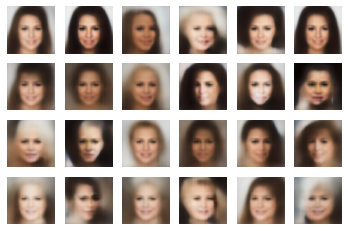


epochs 94
steps128

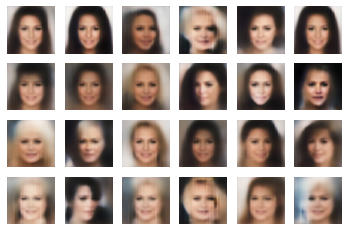


epochs 95
steps128

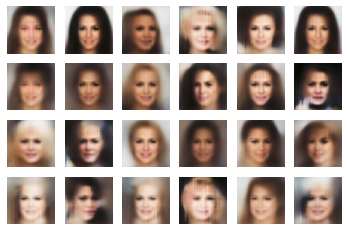


epochs 96
steps128

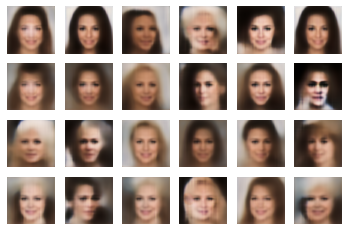


epochs 97
steps128

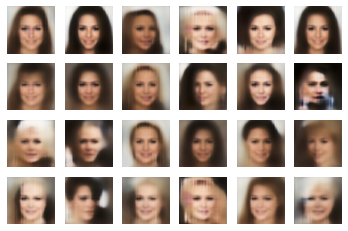


epochs 98
steps128

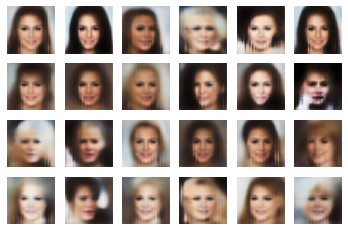


epochs 99
steps128

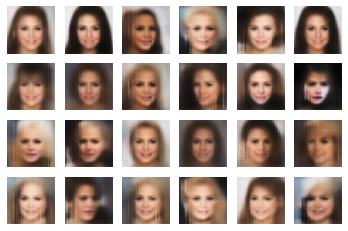


epochs 100
steps128

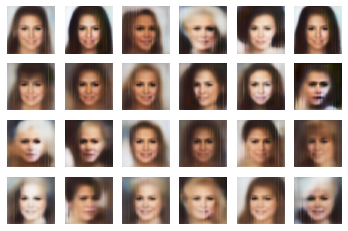


Saving checkpoint at epoch100



epochs 101
steps128

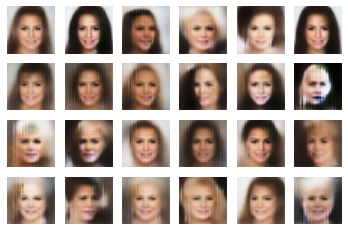


epochs 102
steps128

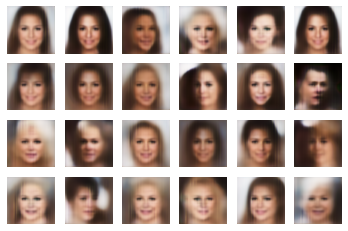


epochs 103
steps128

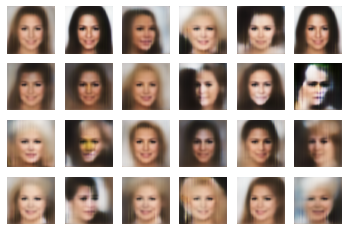


epochs 104
steps128

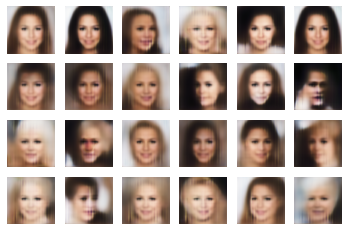


epochs 105
steps128

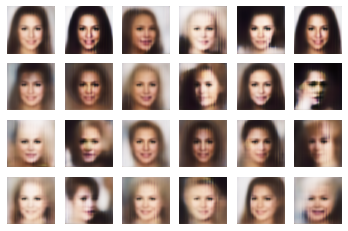


epochs 106
steps128

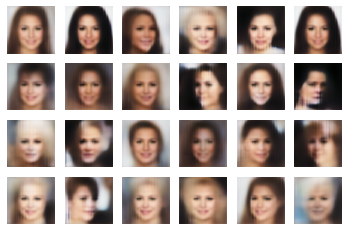


epochs 107
steps128

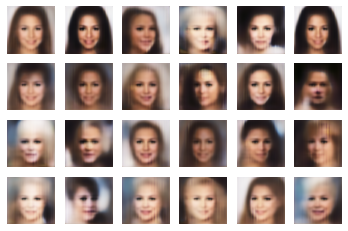


epochs 108
steps128

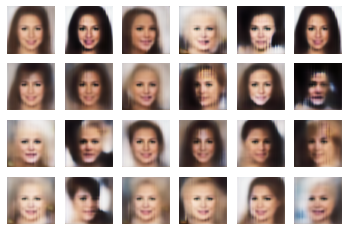


epochs 109
steps128

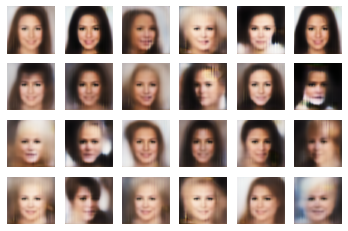


epochs 110
steps128

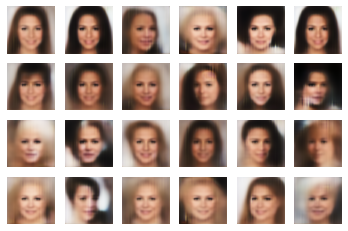


Saving checkpoint at epoch110



epochs 111
steps128

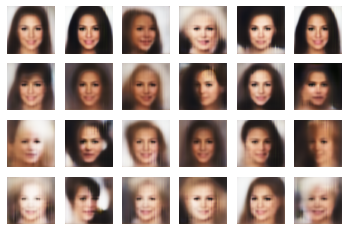


epochs 112
steps128

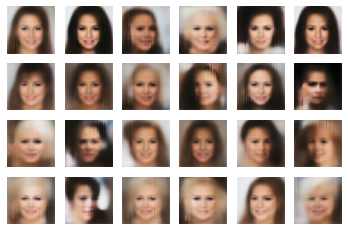


epochs 113
steps128

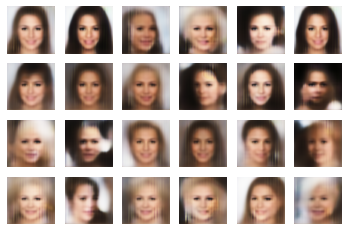


epochs 114
steps128

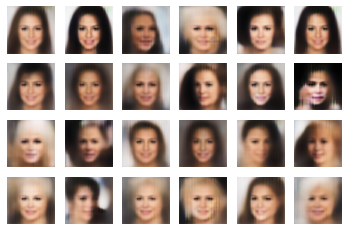


epochs 115
steps128

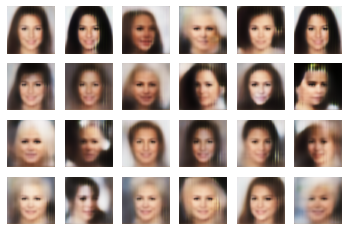


epochs 116
steps128

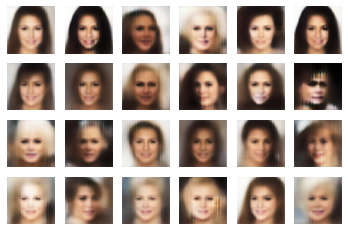


epochs 117
steps128

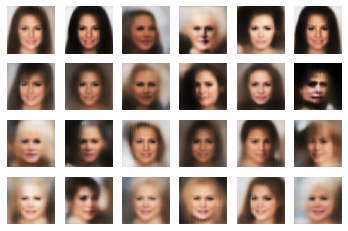


epochs 118
steps128

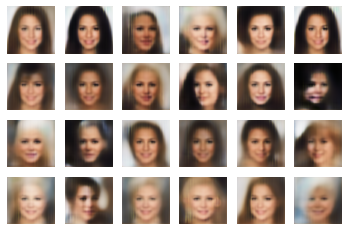


epochs 119
steps128

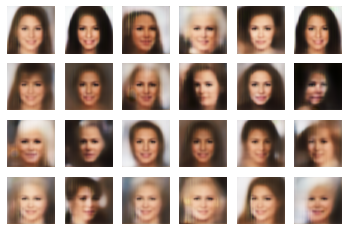


epochs 120
steps128

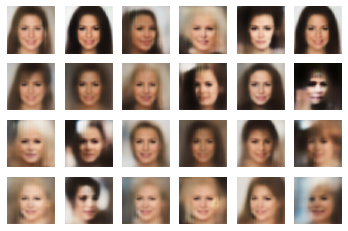


Saving checkpoint at epoch120



epochs 121
steps128

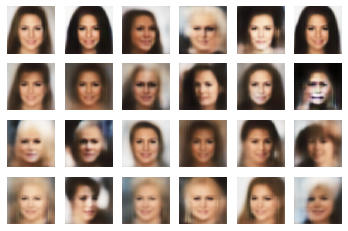


epochs 122
steps128

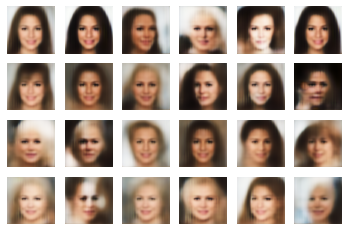


epochs 123
steps128

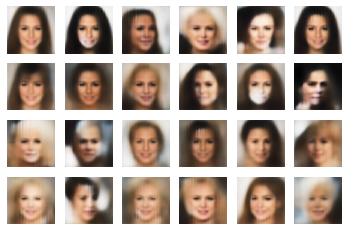


epochs 124
steps128

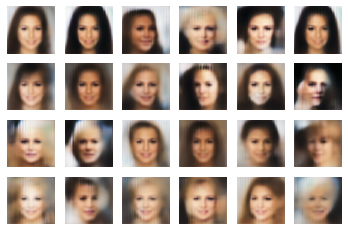


epochs 125
steps128

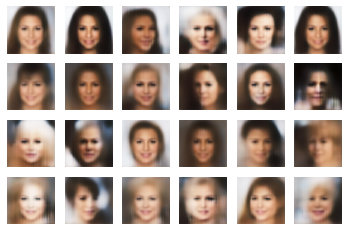


epochs 126
steps128

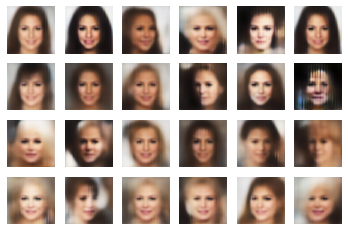


epochs 127
steps128

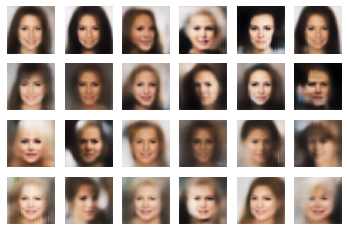


epochs 128
steps128

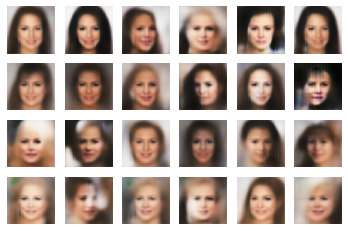


epochs 129
steps128

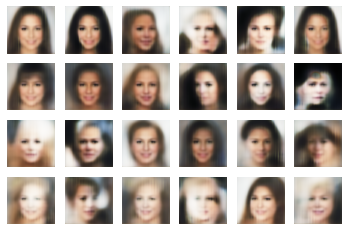


epochs 130
steps128

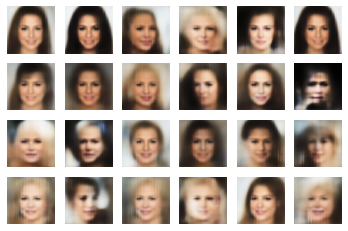


Saving checkpoint at epoch130



epochs 131
steps128

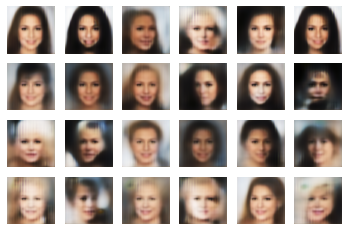


epochs 132
steps128

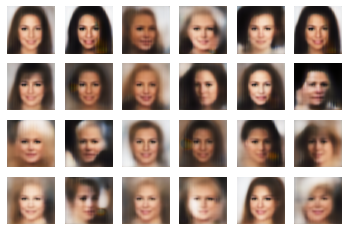


epochs 133
steps128

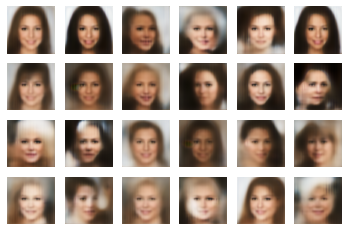


epochs 134
steps128

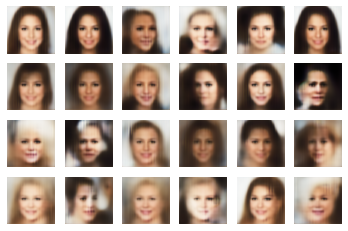


epochs 135
steps128

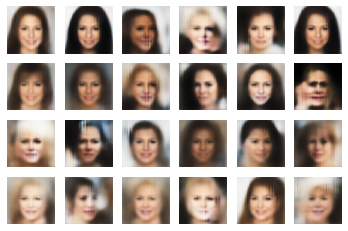


epochs 136
steps128

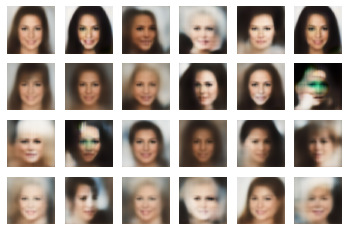


epochs 137
steps128

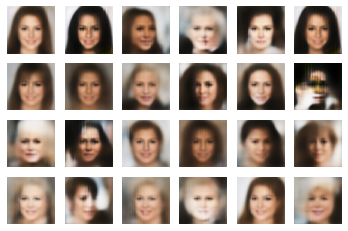


epochs 138
steps128

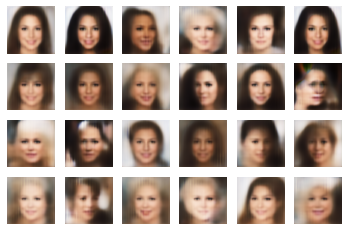


epochs 139
steps128

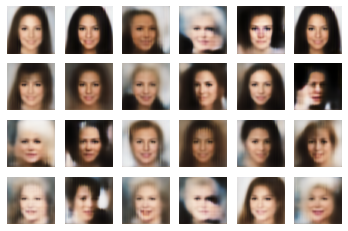


epochs 140
steps128

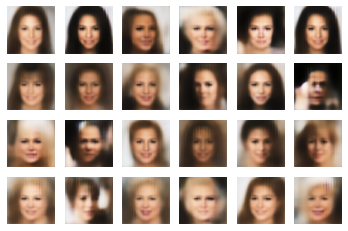


Saving checkpoint at epoch140



epochs 141
steps128

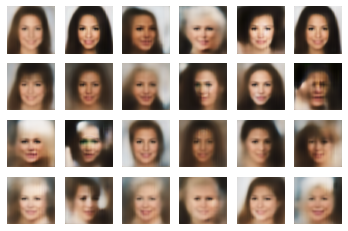


epochs 142
steps128

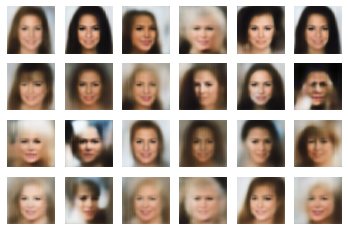


epochs 143
steps128

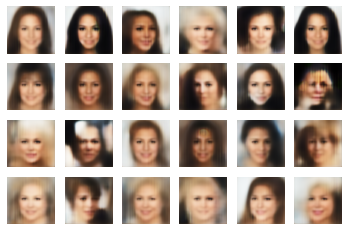


epochs 144
steps128

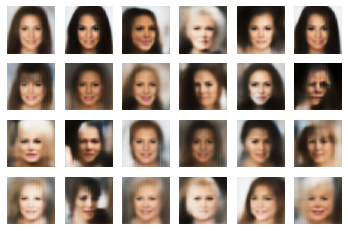


epochs 145
steps128

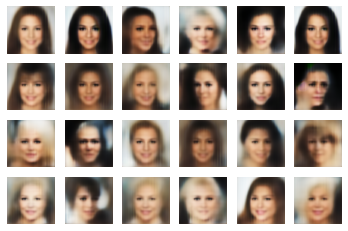


epochs 146
steps128

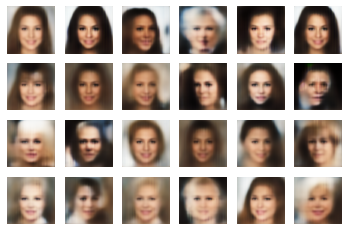


epochs 147
steps128

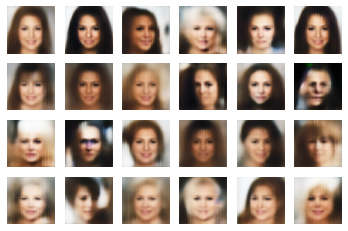


epochs 148
steps128

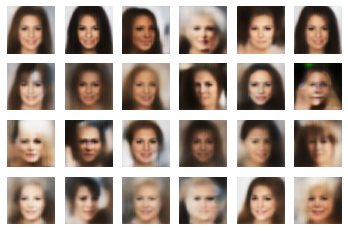


epochs 149
steps128

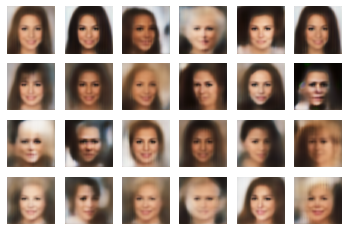


epochs 150
steps128

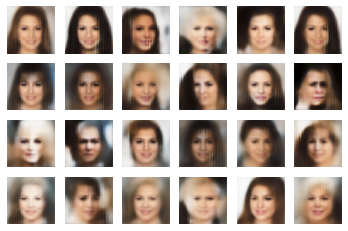


Saving checkpoint at epoch150



epochs 151
steps128

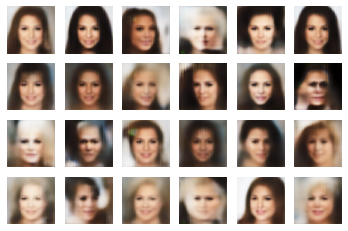


epochs 152
steps128

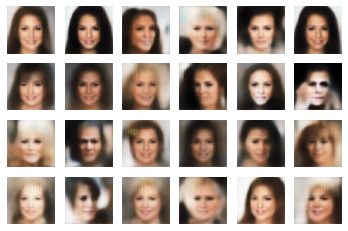


epochs 153
steps128

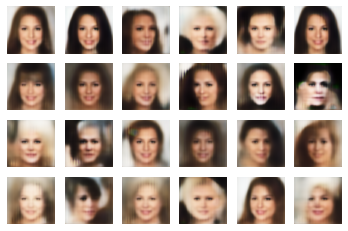


epochs 154
steps128

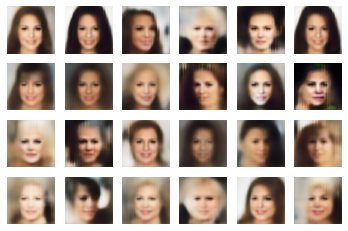


epochs 155
steps128

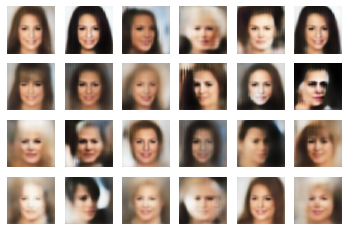


epochs 156
steps128

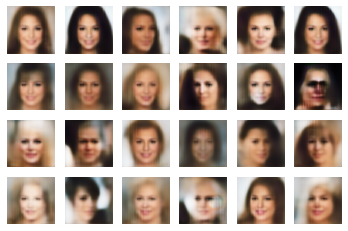


epochs 157
steps128

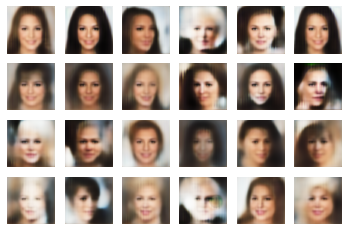


epochs 158
steps128

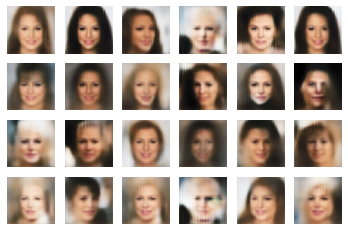


epochs 159
steps128

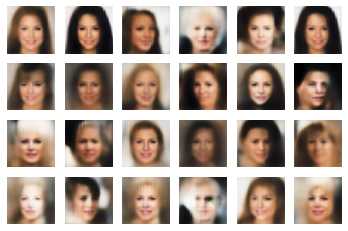


epochs 160
steps128

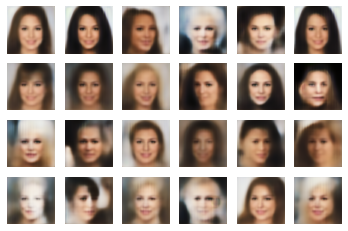


Saving checkpoint at epoch160



epochs 161
steps128

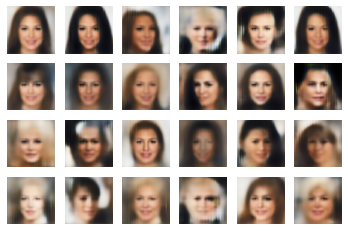


epochs 162
steps128

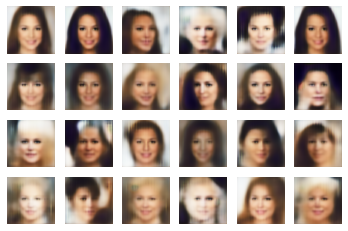


epochs 163
steps128

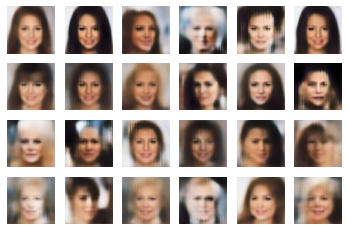


epochs 164
steps128

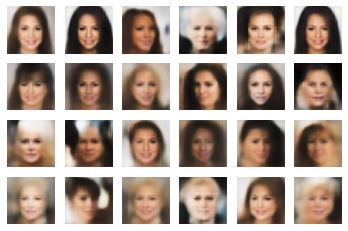


epochs 165
steps128

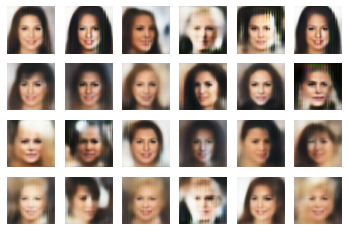


epochs 166
steps128

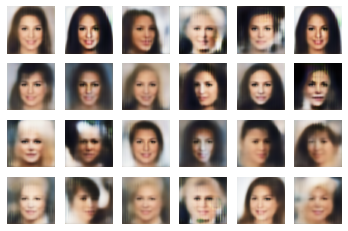


epochs 167
steps128

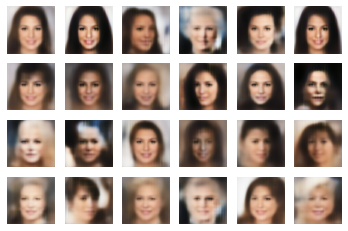


epochs 168
steps128

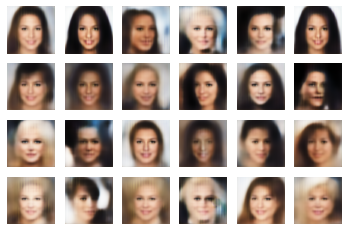


epochs 169
steps128

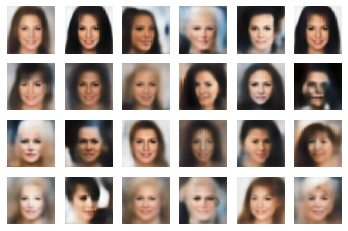


epochs 170
steps128

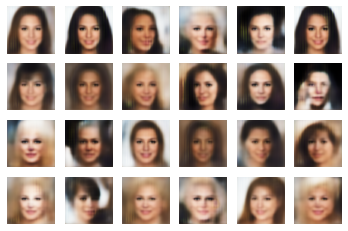


Saving checkpoint at epoch170



epochs 171
steps128

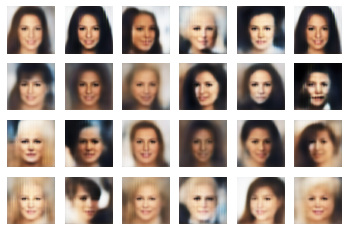


epochs 172
steps128

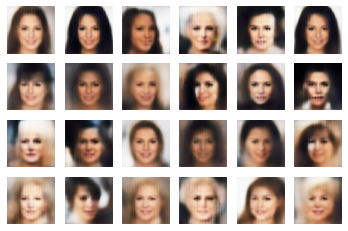


epochs 173
steps128

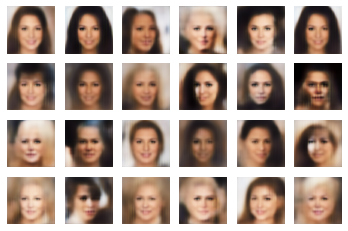


epochs 174
steps128

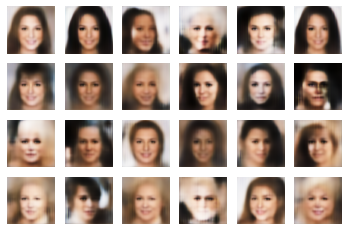


epochs 175
steps128

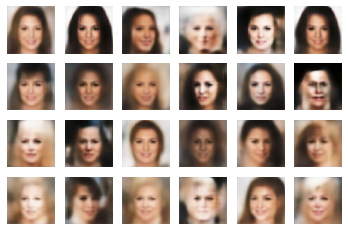


epochs 176
steps128

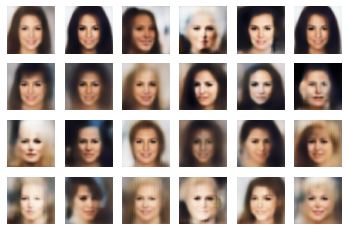


epochs 177
steps128

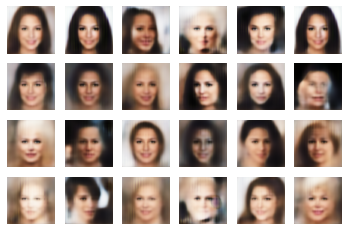


epochs 178
steps128

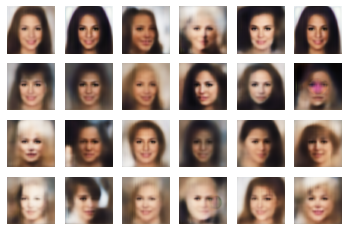


epochs 179
steps128

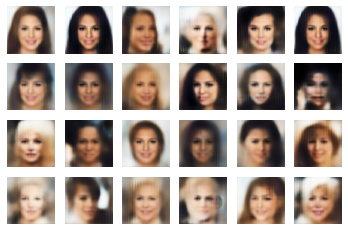


epochs 180
steps128

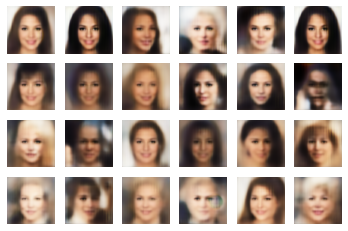


Saving checkpoint at epoch180



epochs 181
steps128

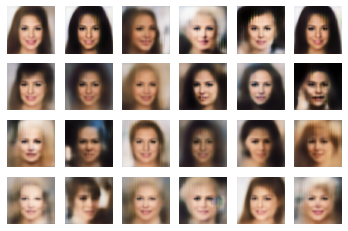


epochs 182
steps128

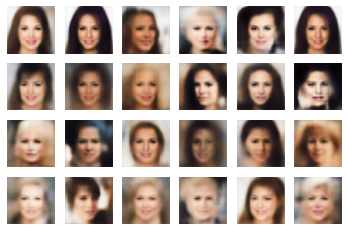


epochs 183
steps128

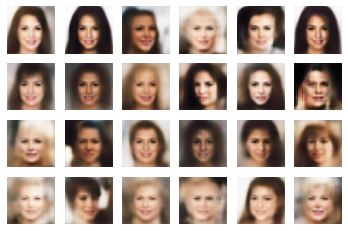


epochs 184
steps128

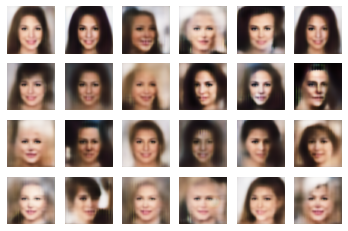


epochs 185
steps128

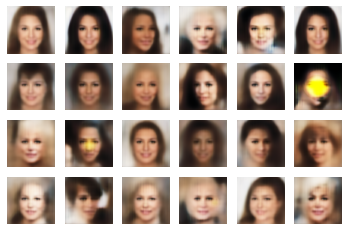


epochs 186
steps128

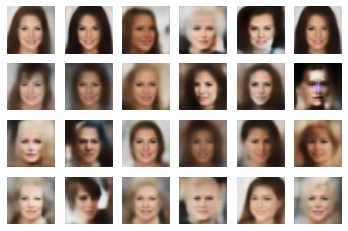


epochs 187
steps128

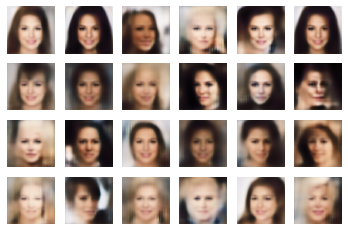


epochs 188
steps128

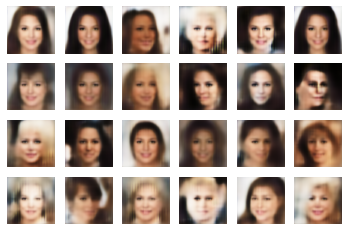


epochs 189
steps128

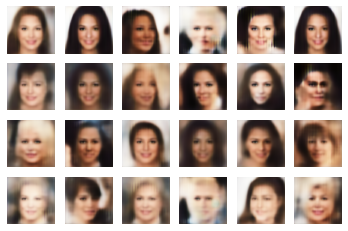


epochs 190
steps128

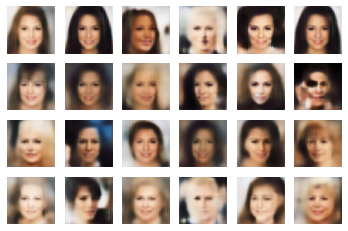


Saving checkpoint at epoch190



epochs 191
steps128

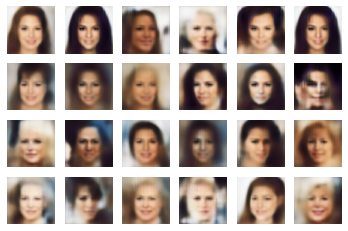


epochs 192
steps128

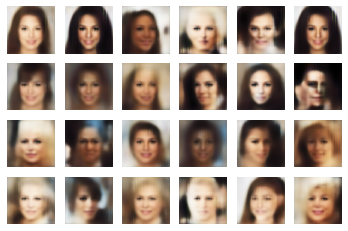


epochs 193
steps128

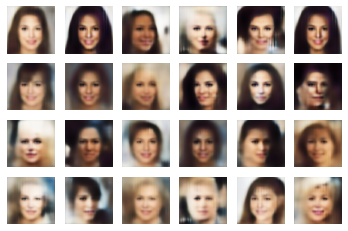


epochs 194
steps128

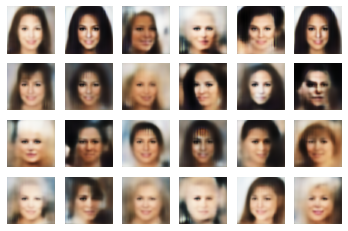


epochs 195
steps128

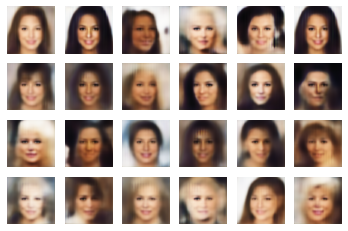


epochs 196
steps128

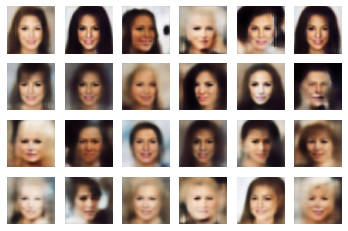


epochs 197
steps128

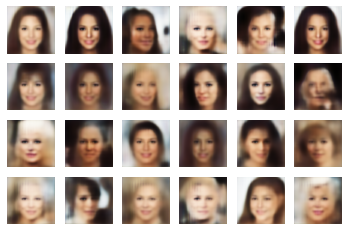


epochs 198
steps128

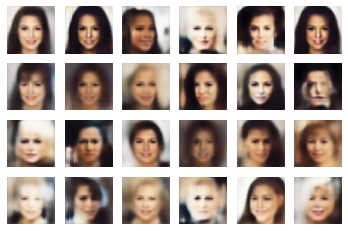


epochs 199
steps128

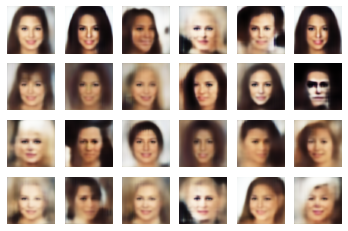


epochs 200
steps128

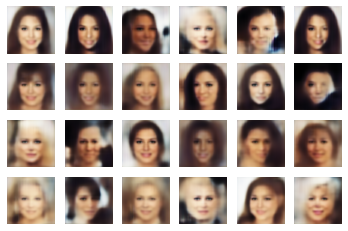


Saving checkpoint at epoch200



epochs 201
steps128

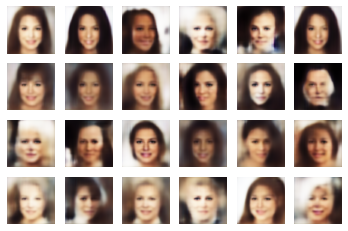


epochs 202
steps128

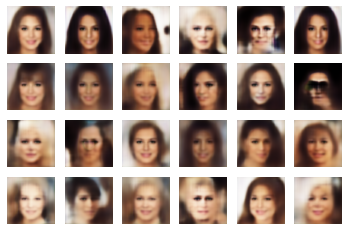


epochs 203
steps128

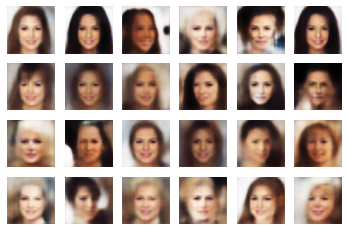


epochs 204
steps128

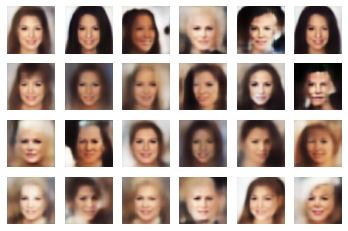


epochs 205
steps128

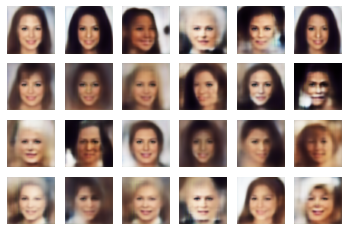


epochs 206
steps128

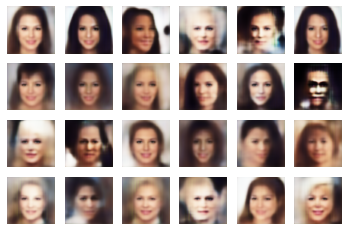


epochs 207
steps128

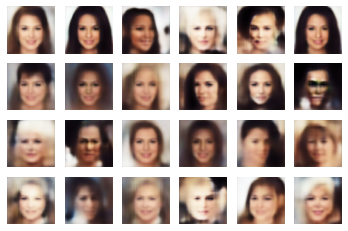


epochs 208
steps128

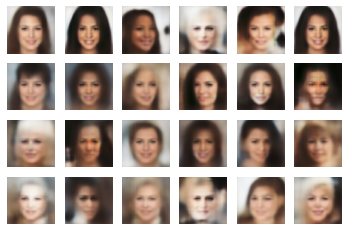


epochs 209
steps33

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import os
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import binary_crossentropy, MSE
import glob
import time
import random
import sys

class ACGAN():
  def __init__(self, 
               img_size=128, 
               code_num = 2048,
               batch_size = 16, 
               train_epochs = 100, 
               train_steps = 8, 
               checkpoint_epochs = 25, 
               image_epochs = 1, 
               start_epoch = 1,
               learning_rate = 1e-4,
               d_rate = 2
               ):
    
    self.batch_size = batch_size
    self.train_epochs =  train_epochs
    self.train_steps = train_steps
    self.checkpoint_epochs = checkpoint_epochs
    self.image_epochs = image_epochs
    self.start_epoch = start_epoch
    self.code_num = code_num
    self.d_rate = d_rate
    self.img_size = img_size
    
    self.gen_optimizer = Adam(learning_rate=learning_rate)
    self.disc_optimizer = Adam(learning_rate=learning_rate)
    self.dec_optimizer = Adam(learning_rate=learning_rate)

    g = Generator()
    self.gen = g.model()
    
    d = Discriminator()
    self.disc = d.model()

    checkpoint_dir = "drive/My Drive/ACGAN/checkpoint"
    checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
    checkpoint = tf.train.Checkpoint(gen_optimizer = self.gen_optimizer,
                                     disc_optimizer = self.disc_optimizer,
                                     dec_optimizer = self.dec_optimizer,
                                     gen = self.gen,
                                     disc = self.disc,
                                     )

    self.manager = tf.train.CheckpointManager(checkpoint, directory=checkpoint_dir, max_to_keep=2)

    train_image_path = 'drive/My Drive/samples/image'
    
    self.train_filenames = glob.glob(train_image_path + '/*.jpg') 

    checkpoint.restore(self.manager.latest_checkpoint)

    self.g_history = []
    self.d_history = []
    self.endec_history = []  

  def preprocess_image(self, image):
    image = tf.image.decode_jpeg(image, channels=3)
    image = tf.image.resize(image, [self.img_size, self.img_size] )
    image = image/255  # normalize to [0,1] range
    return tf.cast(image, tf.float32)

  def load_and_preprocess_image(self, path):
    image = tf.io.read_file(path)
    return self.preprocess_image(image)

  def dataset(self, paths, batch_size):
    AUTOTUNE = tf.data.experimental.AUTOTUNE
    path_ds = tf.data.Dataset.from_tensor_slices(paths)
    img_ds = path_ds.map(self.load_and_preprocess_image, num_parallel_calls=AUTOTUNE)
    img_ds = img_ds.batch(batch_size)
    return img_ds

  def image_preparation(self, filenames, batch_size, steps):
    img_batch = []
    while 1:
      random.shuffle(filenames)
      for path in filenames:
        img_batch.append(path)
        if len(img_batch) == steps*batch_size:
          imgs = self.dataset(img_batch, batch_size)
          img_batch = []
          yield imgs

  def discriminator_loss(self, original_outputs, generated_outputs):
    real_loss = binary_crossentropy(tf.ones_like(original_outputs), original_outputs)
    generated_loss = binary_crossentropy(tf.zeros_like(generated_outputs), generated_outputs)
    loss_d = tf.math.reduce_mean(real_loss + generated_loss)
    return loss_d

  def generator_loss(self, generated_outputs):
    loss_g = tf.math.reduce_mean(binary_crossentropy(tf.ones_like(generated_outputs), generated_outputs))
    return loss_g

  def mse_loss(self, true, pred):
    loss =  tf.math.reduce_mean(MSE(true, pred))
    return loss

  def gan_train(self, imgs):
    noise =tf.random.uniform([self.batch_size, self.code_num], minval=0, maxval=1, dtype=tf.dtypes.float32)

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape, tf.GradientTape() as dec_tape:
      gen_imgs = self.gen(noise, training=True)

      ori_outputs, ori_styles = self.disc(imgs, training=True)
      gen_outputs, gen_styles = self.disc(gen_imgs, training=True)

      gen_loss = self.generator_loss(gen_outputs)      
      disc_loss = self.discriminator_loss(ori_outputs, gen_outputs)

      re_gen_imgs = self.gen(ori_styles, training=True)

      endec_loss = self.mse_loss(imgs, re_gen_imgs)
      self.endec_history.append(endec_loss)
      
      g_loss = gen_loss
      d_loss = disc_loss + 10*endec_loss
      self.g_history.append(g_loss)
      self.d_history.append(d_loss)

    gradients_of_gen = gen_tape.gradient(g_loss, self.gen.trainable_variables)
    self.gen_optimizer.apply_gradients(zip(gradients_of_gen, self.gen.trainable_variables))

    gradients_of_disc = disc_tape.gradient(d_loss, self.disc.trainable_variables)    
    self.disc_optimizer.apply_gradients(zip(gradients_of_disc, self.disc.trainable_variables))

    gradients_of_dec = dec_tape.gradient(endec_loss, self.gen.trainable_variables)
    self.dec_optimizer.apply_gradients(zip(gradients_of_dec, self.gen.trainable_variables))

  def visualise_batch(self, s_1, n):
    gen_img = a.gen(s_1)  
    gen_img = (np.array(gen_img*255, np.uint8))
    fig, axes = plt.subplots(4, 6)
    p = 0
    m = 0
    for img in gen_img:
      axes[p, m].imshow(img)
      axes[p, m].axis('off')
      if m == 5:
        m = 0
        p += 1
      else:
        m += 1

    save_name = 'drive/My Drive/ACGAN/generated_image/'+'image_at_epoch_{:04d}.png'
    plt.savefig(save_name.format(n), dpi=40)
    plt.pause(0.1)
    plt.close('all')

  def loss_vis(self):
    plt.plot(self.g_history, 'b', self.d_history, 'r')
    plt.title('blue:g, red:d')
    plt.savefig('drive/My Drive/ACGAN/loss/gan_loss.png')
    plt.close('all')
    plt.plot(self.endec_history)
    plt.savefig('drive/My Drive/ACGAN/loss/endec_loss.png')
    plt.close('all')

  def __call__(self):
    s_1 =tf.random.uniform([24, self.code_num], minval=0, maxval=1, dtype=tf.dtypes.float32)

    image_loader = self.image_preparation(self.train_filenames, self.batch_size, self.train_steps)

    for n in range(self.start_epoch, self.train_epochs+1):

      print ('\nepochs {}'.format(n))

      imgs_ds = next(image_loader)

      for steps, imgs in enumerate(imgs_ds):
        print("\r" + 'steps{}'.format(steps+1), end="")
        sys.stdout.flush()
        self.gan_train(imgs)
          
      self.loss_vis()
           
      if n % self.image_epochs == 0 or n < 50:
        self.visualise_batch(s_1, n)

      if n % self.checkpoint_epochs == 0:
        print ('\nSaving checkpoint at epoch{}\n\n'.format(n))
        self.manager.save()
      
      g_ave = sum(self.g_history[-self.train_steps:])/self.train_steps
      d_ave = sum(self.d_history[-self.train_steps:])/self.train_steps
      if g_ave > d_ave:
        print ('\nSaving last checkpoint at epoch{}\n\n'.format(n))
        self.manager.save()
        break

if __name__ == '__main__':
  a = ACGAN(img_size = 128,
                   code_num = 8,
                   batch_size = 16,
                   train_epochs = 10000, 
                   train_steps = 128, 
                   checkpoint_epochs = 10, 
                   image_epochs = 1, 
                   start_epoch = 1,
                   learning_rate = 1e-4
                  )
  a()